In [1]:
from google.colab import drive
import os

# Mount Google Drive

drive.mount("/content/drive", force_remount=True)

%cd "/content/drive/MyDrive/Selected_Topics_HW3/"

Mounted at /content/drive
/content/drive/MyDrive/Selected_Topics_HW3


In [2]:
# note: this cell should only be run once
# Extract training and validation data

!tar -xzvf "/content/drive/MyDrive/Selected_Topics_HW3/hw3-data-release.tar.gz" -C "/content/drive/MyDrive/Selected_Topics_HW3/"

In [3]:
# note: this cell should only be run once
!pip install tifffile

In [4]:
import glob as glob
from pprint import pprint
import random
import re
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def sorted_alphanumeric(data):
    convert = lambda text: int(text) if text.isdigit() else text.lower()
    alphanum_key = lambda key: [ convert(c) for c in re.split('([0-9]+)', key) ]
    return sorted(data, key=alphanum_key)

root_dir = os.path.join(os.getcwd())
print(root_dir)
train_dir = root_dir + '/train/'

train_paths = os.listdir(train_dir)
all_images = [image_path.split('/')[-1] for image_path in train_paths]
all_images = sorted(all_images)
train_images = sorted_alphanumeric(all_images)
print(f"Train instances: {len(train_images)}")

/content/drive/MyDrive/Selected_Topics_HW3
Train instances: 209


['image.tif', 'class4.tif']
width = 1044, height = 717


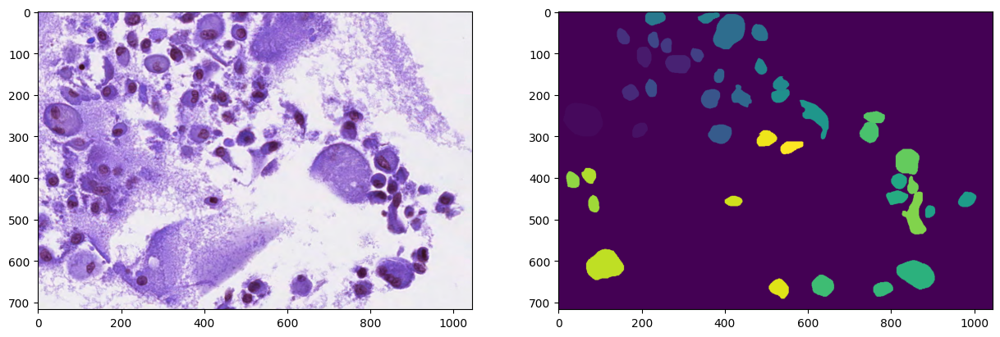

In [5]:
from PIL import Image
from tifffile import imread
from torchvision.ops import masks_to_boxes
import cv2

root_dir = os.path.join(os.getcwd())

img_location = root_dir + '/train/9e977bbd-fbec-4564-86bf-101c90cd2b9d/image.tif'
print(os.listdir(root_dir+ '/train/9e977bbd-fbec-4564-86bf-101c90cd2b9d/'))
mask1_location = root_dir + '/train/9e977bbd-fbec-4564-86bf-101c90cd2b9d/class4.tif'

img = mpimg.imread(img_location)

mask1 = imread(mask1_location)

f, axarr = plt.subplots(nrows=1, ncols=2, figsize=(15, 10))
axarr[0].imshow(img)
axarr[1].imshow(mask1)

image_width = img.shape[1]
image_height = img.shape[0]
print(f"width = {image_width}, height = {image_height}")

In [6]:
import os
import numpy as np
import torch
import matplotlib.pyplot as plt

import torchvision.transforms.functional as F


ASSETS_DIRECTORY = "assets"

plt.rcParams["savefig.bbox"] = "tight"


def show(imgs):
    if not isinstance(imgs, list):
        imgs = [imgs]
    fix, axs = plt.subplots(ncols=len(imgs), squeeze=False)
    fix.set_figheight(150)
    fix.set_figwidth(150)
    for i, img in enumerate(imgs):
        img = img.detach()
        img = F.to_pil_image(img)
        axs[0, i].imshow(np.asarray(img))
        axs[0, i].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])

['image.tif', 'class4.tif']
Total # of objects:  42


<ipython-input-7-fe7e47f2e889>:28: UserWarning: The given NumPy array is not writable, and PyTorch does not support non-writable tensors. This means writing to this tensor will result in undefined behavior. You may want to copy the array to protect its data or make it writable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at /pytorch/torch/csrc/utils/tensor_numpy.cpp:203.)
  imgt = torch.from_numpy(img[:,:,0:3]).permute(2, 0, 1)


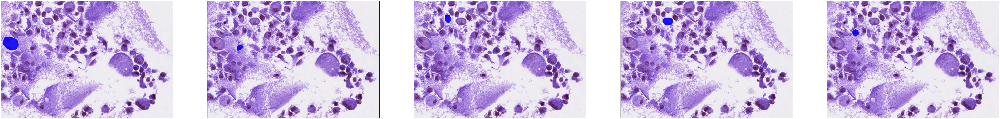

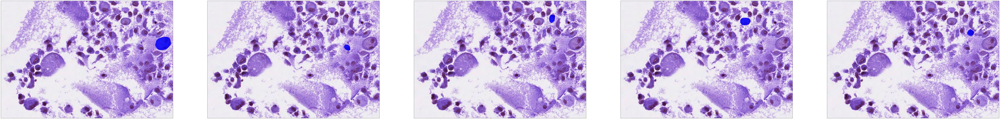

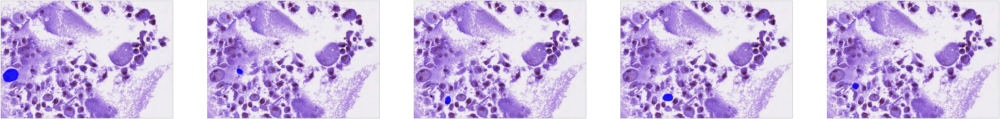

In [7]:
# extract instances and bounding boxes
from torchvision.io import read_image
import torch
import torch.nn.functional
from torchvision.utils import draw_segmentation_masks
root_dir = os.path.join(os.getcwd())

img_location = root_dir + '/train/9e977bbd-fbec-4564-86bf-101c90cd2b9d/image.tif'
print(os.listdir(root_dir+ '/train/9e977bbd-fbec-4564-86bf-101c90cd2b9d/'))
mask1_location = root_dir + '/train/9e977bbd-fbec-4564-86bf-101c90cd2b9d/class4.tif'

img = mpimg.imread(img_location)

# We get the unique colors, as these would be the object ids.
mask1t = torch.from_numpy(mask1)
obj_ids = torch.unique(mask1t)

# first id is the background, so remove it.
obj_ids = obj_ids[1:]
print("Total # of objects: ", len(obj_ids))

# split the color-encoded mask into a set of boolean masks.
# Note that this snippet would work as well if the masks were float values instead of ints.
masks = mask1t == obj_ids[:, None, None]

drawn_masks = []

imgt = torch.from_numpy(img[:,:,0:3]).permute(2, 0, 1)
# display first 5 masks
for mask in masks[0:5]:
    drawn_masks.append(draw_segmentation_masks(imgt, mask, alpha=0.8, colors="blue"))
show(drawn_masks)

# flip image and mask horizontally
mask_horflip = torch.flip(mask1t, dims=[-1])
imgtensor = torch.from_numpy(img[:,:,0:3]).permute(2, 0, 1)
imgt_horflip = torch.flip(imgtensor, dims=[-1])

obj_ids = torch.unique(mask_horflip)

# first id is the background, so remove it.
obj_ids = obj_ids[1:]
masks_horflip = mask_horflip == obj_ids[:, None, None]

drawn_masks = []
# display first 5 masks
for mask in masks_horflip[0:5]:
    drawn_masks.append(draw_segmentation_masks(imgt_horflip, mask, alpha=0.8, colors="blue"))
show(drawn_masks)

# flip image and mask vertically
mask_verflip = torch.flip(mask1t, dims=[-2])
imgtensor = torch.from_numpy(img[:,:,0:3]).permute(2, 0, 1)
imgt_verflip = torch.flip(imgtensor, dims=[-2])

obj_ids = torch.unique(mask_verflip)

# first id is the background, so remove it.
obj_ids = obj_ids[1:]
masks_verflip = mask_verflip == obj_ids[:, None, None]

drawn_masks = []
# display first 5 masks
for mask in masks_verflip[0:5]:
    drawn_masks.append(draw_segmentation_masks(imgt_verflip, mask, alpha=0.8, colors="blue"))
show(drawn_masks)


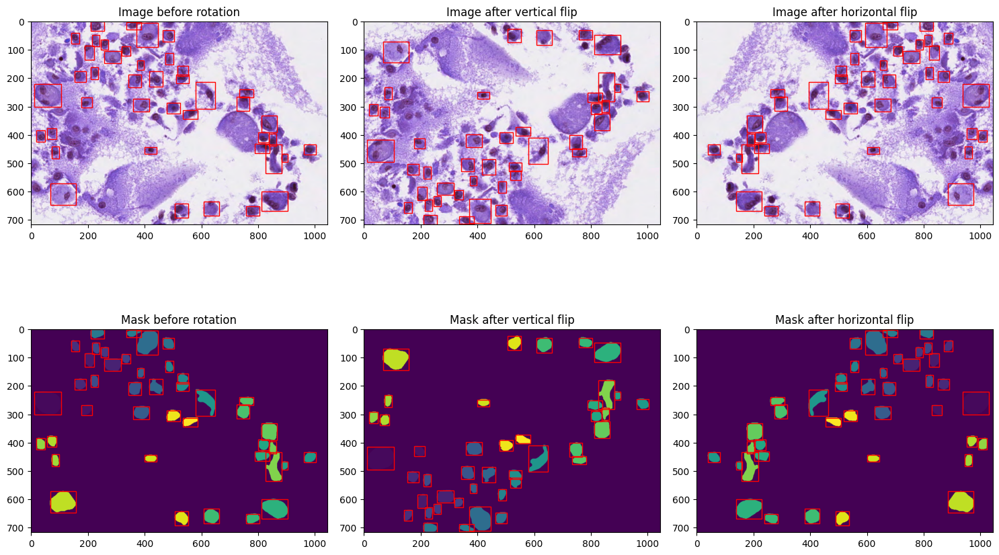

In [8]:
from torchvision.ops import masks_to_boxes
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.patches as patches

boxes = masks_to_boxes(masks)
boxes_verflip = masks_to_boxes(masks_verflip)
boxes_horflip = masks_to_boxes(masks_horflip)

fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(15,10))

ax[0,0].imshow(img)
ax[0,0].set_title("Image before rotation")
ax[1,0].imshow(mask1)
ax[1,0].set_title("Mask before rotation")

for box_num, box in enumerate(boxes):
    # Create a Rectangle patch
    rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1], linewidth=1, edgecolor='r', facecolor='none')
    ax[0,0].add_patch(rect)
    rect2 = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1], linewidth=1, edgecolor='r', facecolor='none')
    ax[1,0].add_patch(rect2)

ax[0,1].imshow(imgt_verflip.permute(1,2,0).numpy())
ax[0,1].set_title("Image after vertical flip")
ax[1,1].imshow(mask_verflip.numpy())
ax[1,1].set_title("Mask after vertical flip")

for box_num, box in enumerate(boxes_verflip):
    # Create a Rectangle patch
    rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1], linewidth=1, edgecolor='r', facecolor='none')
    ax[0,1].add_patch(rect)
    rect2 = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1], linewidth=1, edgecolor='r', facecolor='none')
    ax[1,1].add_patch(rect2)

ax[0,2].imshow(imgt_horflip.permute(1,2,0).numpy())
ax[0,2].set_title("Image after horizontal flip")
ax[1,2].imshow(mask_horflip.numpy())
ax[1,2].set_title("Mask after horizontal flip")

for box_num, box in enumerate(boxes_horflip):
    # Create a Rectangle patch
    rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1], linewidth=1, edgecolor='r', facecolor='none')
    ax[0,2].add_patch(rect)
    rect2 = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1], linewidth=1, edgecolor='r', facecolor='none')
    ax[1,2].add_patch(rect2)

plt.tight_layout()
plt.show()



In [9]:
from PIL import Image
from tifffile import imread
from torchvision.ops import masks_to_boxes
from tifffile import imread
import torch
from PIL import Image
import torchvision.transforms as transforms
import cv2

root_dir = os.path.join(os.getcwd())
train_dir = root_dir + '/train/'


class CellDataset(object):
    def __init__(self, root, transforms=None): # transforms
        self.root = root
        self.transforms=[]
        if transforms!=None:
          self.transforms.append(transforms)
        # load all image files, sorting them to ensure that they are aligned
        self.imgs = sorted_alphanumeric(os.listdir(root))

    def __getitem__(self, idx):
        folder_path = os.path.join(self.root, self.imgs[idx])
        img_path = os.path.join(self.root, self.imgs[idx], "image.tif")
        img = Image.open(img_path).convert("RGB")
        img = np.array(img).astype(np.float32)
        # normalize image
        img /= 255.0
        # bring color channels to front
        img = np.transpose(img, (2, 0, 1)).astype(np.float32)
        mask_data = glob.glob(f"{folder_path}/class*.tif")
        mask_data = sorted_alphanumeric(mask_data)
        boxes = torch.tensor([])
        labels = torch.tensor([])
        areas = torch.tensor([])
        masks = torch.tensor([])
        iscrowd = torch.tensor([])
        for mask_location in mask_data:
            label = [mask_location.split('/')[-1]][-1].split('.')[-2]
            label = int(label[-1])
            mask = imread(mask_location)
            # convert mask to tensor
            mask_resized = torch.from_numpy(mask)
            # instances are encoded as different colors
            obj_ids = np.unique(mask_resized)
            # first id is the background, so remove it.
            obj_ids = obj_ids[1:]
            num_objs = len(obj_ids)
            masks_i = mask_resized == obj_ids[:, None, None]
            boxes_i = masks_to_boxes(masks_i)
            # convert everything into a torch.Tensor
            boxes_i = torch.as_tensor(boxes_i, dtype=torch.float32)
            # there is only one class
            labels_i = torch.full((num_objs,), label, dtype=torch.int64)
            masks_i = torch.as_tensor(masks_i, dtype=torch.uint8)
            boxes = torch.cat((boxes, boxes_i))
            labels = torch.cat((labels, labels_i))
            masks = torch.cat((masks, masks_i))
            area_i = (boxes_i[:, 3] - boxes_i[:, 1]) * (boxes_i[:, 2] - boxes_i[:, 0])
            # suppose all instances are not crowd
            iscrowd = torch.cat((iscrowd, torch.zeros((num_objs,), dtype=torch.int64)))
            areas = torch.cat((areas, area_i))


        image_id = torch.tensor([idx])

        for i in self.transforms:
          img = i(img)
        target = {}
        target["boxes"] = boxes
        labels = labels.long()
        target["labels"] = labels
        target["areas"] = areas
        target["masks"] = masks
        image_id = torch.tensor(idx)
        target["image_id"] = image_id
        img = torch.from_numpy(img)
        return img.double(), target

    def __len__(self):
        return len(self.imgs)

/content/drive/MyDrive/Selected_Topics_HW3


In [10]:
class CellDataset_verflip(object):
    def __init__(self, root, transforms=None): # transforms
        self.root = root
        self.transforms=[]
        if transforms!=None:
          self.transforms.append(transforms)
        # load all image files, sorting them to ensure that they are aligned
        self.imgs = sorted_alphanumeric(os.listdir(root))

    def __getitem__(self, idx):
        folder_path = os.path.join(self.root, self.imgs[idx])
        img_path = os.path.join(self.root, self.imgs[idx], "image.tif")
        img = Image.open(img_path).convert("RGB")
        img = np.array(img).astype(np.float32)

        # normalize image
        img /= 255.0
        # bring color channels to front
        img = np.transpose(img, (2, 0, 1)).astype(np.float32)

        mask_data = glob.glob(f"{folder_path}/class*.tif")
        mask_data = sorted_alphanumeric(mask_data)
        boxes = torch.tensor([])
        labels = torch.tensor([])
        areas = torch.tensor([])
        masks = torch.tensor([])
        iscrowd = torch.tensor([])
        for mask_location in mask_data:
            label = [mask_location.split('/')[-1]][-1].split('.')[-2]
            label = int(label[-1])
            mask = imread(mask_location)
            # flip mask vertically
            mask_resized = torch.flip(torch.from_numpy(mask), dims=[-2])
            # instances are encoded as different colors
            obj_ids = np.unique(mask_resized)
            # first id is the background, so remove it.
            obj_ids = obj_ids[1:]
            num_objs = len(obj_ids)
            masks_i = mask_resized == obj_ids[:, None, None]
            boxes_i = masks_to_boxes(masks_i)
            # convert everything into a torch.Tensor
            boxes_i = torch.as_tensor(boxes_i, dtype=torch.float32)
            # there is only one class
            labels_i = torch.full((num_objs,), label, dtype=torch.int64)
            masks_i = torch.as_tensor(masks_i, dtype=torch.uint8)
            boxes = torch.cat((boxes, boxes_i))
            labels = torch.cat((labels, labels_i))
            masks = torch.cat((masks, masks_i))
            area_i = (boxes_i[:, 3] - boxes_i[:, 1]) * (boxes_i[:, 2] - boxes_i[:, 0])
            # suppose all instances are not crowd
            iscrowd = torch.cat((iscrowd, torch.zeros((num_objs,), dtype=torch.int64)))
            areas = torch.cat((areas, area_i))


        image_id = torch.tensor([idx])

        for i in self.transforms:
          img = i(img)
        target = {}
        target["boxes"] = boxes
        labels = labels.long()
        target["labels"] = labels
        target["areas"] = areas
        target["masks"] = masks
        image_id = torch.tensor(idx)
        target["image_id"] = image_id
        # flip image vertically
        img = torch.flip(torch.from_numpy(img), dims=[-2])
        return img.double(), target

    def __len__(self):
        return len(self.imgs)


class CellDataset_horflip(object):
    def __init__(self, root, transforms=None): # transforms
        self.root = root
        self.transforms=[]
        if transforms!=None:
          self.transforms.append(transforms)
        # load all image files, sorting them to ensure that they are aligned
        self.imgs = sorted_alphanumeric(os.listdir(root))

    def __getitem__(self, idx):
        folder_path = os.path.join(self.root, self.imgs[idx])
        img_path = os.path.join(self.root, self.imgs[idx], "image.tif")
        img = Image.open(img_path).convert("RGB")
        img = np.array(img).astype(np.float32)

        # normalize image
        img /= 255.0
        # bring color channels to front
        img = np.transpose(img, (2, 0, 1)).astype(np.float32)

        mask_data = glob.glob(f"{folder_path}/class*.tif")
        mask_data = sorted_alphanumeric(mask_data)
        boxes = torch.tensor([])
        labels = torch.tensor([])
        areas = torch.tensor([])
        masks = torch.tensor([])
        iscrowd = torch.tensor([])
        for mask_location in mask_data:
            label = [mask_location.split('/')[-1]][-1].split('.')[-2]
            label = int(label[-1])
            #print("label ", label)
            mask = imread(mask_location)
            #flip mask horizontally
            mask_resized = torch.flip(torch.from_numpy(mask), dims=[-1])
            # instances are encoded as different colors
            obj_ids = np.unique(mask_resized)
            # first id is the background, so remove it.
            obj_ids = obj_ids[1:]
            num_objs = len(obj_ids)
            masks_i = mask_resized == obj_ids[:, None, None]
            boxes_i = masks_to_boxes(masks_i)
            # convert everything into a torch.Tensor
            boxes_i = torch.as_tensor(boxes_i, dtype=torch.float32)
            # there is only one class
            labels_i = torch.full((num_objs,), label, dtype=torch.int64)
            masks_i = torch.as_tensor(masks_i, dtype=torch.uint8)
            boxes = torch.cat((boxes, boxes_i))
            labels = torch.cat((labels, labels_i))
            masks = torch.cat((masks, masks_i))
            area_i = (boxes_i[:, 3] - boxes_i[:, 1]) * (boxes_i[:, 2] - boxes_i[:, 0])
            # suppose all instances are not crowd
            iscrowd = torch.cat((iscrowd, torch.zeros((num_objs,), dtype=torch.int64)))
            areas = torch.cat((areas, area_i))


        image_id = torch.tensor([idx])

        for i in self.transforms:
          img = i(img)
        target = {}
        target["boxes"] = boxes
        labels = labels.long()
        target["labels"] = labels
        target["areas"] = areas
        target["masks"] = masks
        image_id = torch.tensor(idx)
        target["image_id"] = image_id
        # flip image horizontally
        img = torch.flip(torch.from_numpy(img), dims=[-1])
        return img.double(), target

    def __len__(self):
        return len(self.imgs)

In [11]:
def collate_fn(batch):
    """
    To handle the data loading as different images may have different number
    of objects and to handle varying size tensors as well.
    """
    return tuple(zip(*batch))

import torch
from torch.utils.data import Dataset, DataLoader, random_split, ConcatDataset
BATCH_SIZE = 1
# full_dataset = CellDataset(train_dir)
full_dataset = ConcatDataset([CellDataset(train_dir), CellDataset_verflip(train_dir), CellDataset_horflip(train_dir)])

train_size = int(0.9 * len(full_dataset))
val_size = len(full_dataset) - train_size

# Split the dataset
train_dataset, valid_dataset = random_split(full_dataset, [train_size, val_size])

# Create data loaders
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(valid_dataset, batch_size=32, shuffle=False)
train_loader = DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=0,
    collate_fn = collate_fn
)
valid_loader = DataLoader(
    valid_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=0,
    collate_fn=collate_fn
)
print(f"Number of training samples: {len(train_dataset)}")
print(f"Number of training batches: {len(train_loader)}")
print(f"Number of validation samples: {len(valid_dataset)}")
print(f"Number of validation batches: {len(valid_loader)}")

# images, targets = next(iter(train_loader))

Number of training samples: 564
Number of training batches: 564
Number of validation samples: 63
Number of validation batches: 63


#  Train

In [14]:
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.mask_rcnn import MaskRCNNPredictor

num_classes = 5 # 4 types of cells + background
# load an instance segmentation model pre-trained pre-trained on COCO
model = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=True)
# get number of input features for the classifier
in_features = model.roi_heads.box_predictor.cls_score.in_features
# replace the pre-trained head with a new one
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
# now get the number of input features for the mask classifier
in_features_mask = model.roi_heads.mask_predictor.conv5_mask.in_channels
hidden_layer = 256
# and replace the mask predictor with a new one
model.roi_heads.mask_predictor = MaskRCNNPredictor(in_features_mask,
                                                    hidden_layer,
                                                    num_classes)

total_parameters = sum(p.numel() for p in model.parameters())
print("Total # of parameters: ", total_parameters)

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
print(device)
model=model.to(device)

params = [p for p in model.parameters() if p.requires_grad]
# optimizer = torch.optim.Adam(params, lr=1e-7, betas=(0.9, 0.999), eps=1e-08)
optimizer = torch.optim.SGD(params, lr=1e-6, momentum=0.9, weight_decay=0.0005)

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MaskRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=MaskRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Total # of parameters:  43938541
cuda


In [13]:
# Perform training loop for n epochs
from tqdm.auto import tqdm
import time

class Averager:
    def __init__(self):
        self.current_total = 0.0
        self.iterations = 0.0

    def send(self, value):
        self.current_total += value
        self.iterations += 1

    @property
    def value(self):
        if self.iterations == 0:
            return 0
        else:
            return 1.0 * self.current_total / self.iterations

    def reset(self):
        self.current_total = 0.0
        self.iterations = 0.0

def save_model(epoch, model, optimizer):
    """
    Function to save the trained model till current epoch, or whenever called
    """
    torch.save({
                'epoch': epoch+1,
                'model_state_dict': model.state_dict(),
                'optimizer_state_dict': optimizer.state_dict(),
                }, OUT_DIR + f'/checkpoint7.pth')

def save_loss_plot(OUT_DIR, train_loss, val_loss, epoch):
    figure_1, train_ax = plt.subplots()
    figure_2, valid_ax = plt.subplots()
    train_ax.plot(train_loss, color='tab:blue')
    train_ax.set_xlabel('iterations')
    train_ax.set_ylabel('train loss')
    valid_ax.plot(val_loss, color='tab:red')
    valid_ax.set_xlabel('iterations')
    valid_ax.set_ylabel('validation loss')
    figure_1.savefig(OUT_DIR + f"/train_loss7.png")
    figure_2.savefig(OUT_DIR + f"/valid_loss7.png")
    print('SAVING PLOTS COMPLETE...')
    plt.close('all')

def train(train_data_loader, model):
    print('Training')
    global train_itr
    global train_loss_list

     # initialize tqdm progress bar
    prog_bar = tqdm(train_data_loader, total=len(train_data_loader))

    for i, data in enumerate(prog_bar):
        optimizer.zero_grad()
        images, targets = data
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
        optimizer.zero_grad()
        model=model.double()
        loss_dict = model(images, targets)

        losses = sum(loss for loss in loss_dict.values())
        loss_value = losses.item()
        train_loss_list.append(loss_value)
        train_loss_hist.send(loss_value)

        losses.backward()
        optimizer.step()
        train_itr+=1
        # update the loss value beside the progress bar for each iteration
        prog_bar.set_description(desc=f"Loss: {loss_value:.4f}")


    return train_loss_list


# initialize the Averager class
train_loss_hist = Averager()
val_loss_hist = Averager()
train_itr = 1
val_itr = 1
train_loss_list = []
val_loss_list = []
# name to save the trained model with
MODEL_NAME = 'model'
OUT_DIR =  root_dir + '/output/'

n_epochs = 100
model.train()
for epoch in range(n_epochs):
    print(f"\nEPOCH {epoch+1} of {n_epochs}")
    train_loss_hist.reset()
    val_loss_hist.reset()
    start = time.time()

    # initialize tqdm progress bar
    prog_bar = tqdm(train_loader, total=len(train_loader))

    for i, data in enumerate(prog_bar):
        optimizer.zero_grad()
        images, targets = data
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
        optimizer.zero_grad()
        model=model.double()
        loss_dict = model(images, targets)

        losses = sum(loss for loss in loss_dict.values())
        loss_value = losses.item()
        train_loss_list.append(loss_value)
        train_loss_hist.send(loss_value)

        losses.backward()
        optimizer.step()
        train_itr+=1
        # update the loss value beside the progress bar for each iteration
        prog_bar.set_description(desc=f"Loss: {loss_value:.4f}")

    # initialize tqdm progress bar
    prog_bar = tqdm(valid_loader, total=len(valid_loader))

    for i, data in enumerate(prog_bar):
        images, targets = data

        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
        with torch.no_grad():
            model=model.double()
            loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())
        loss_value = losses.item()
        val_loss_list.append(loss_value)
        val_loss_hist.send(loss_value)
        val_itr += 1
        # update the loss value beside the progress bar for each iteration
        prog_bar.set_description(desc=f"Loss: {loss_value:.4f}")

    print(f"Epoch #{epoch+1} train loss: {train_loss_hist.value:.3f}")
    print(f"Epoch #{epoch+1} validation loss: {val_loss_hist.value:.3f}")
    end = time.time()
    save_model(epoch, model, optimizer)
    # save loss plot  11q
    save_loss_plot(OUT_DIR, train_loss_list, val_loss_list, epoch)



EPOCH 1 of 100


  0%|          | 0/564 [00:00<?, ?it/s]

  0%|          | 0/63 [00:00<?, ?it/s]

Epoch #1 train loss: 4.307
Epoch #1 validation loss: 3.117
SAVING PLOTS COMPLETE...

EPOCH 2 of 100


  0%|          | 0/564 [00:00<?, ?it/s]

KeyboardInterrupt: 

# Test

In [48]:
import time
import json
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.mask_rcnn import MaskRCNNPredictor
import glob as glob
from pprint import pprint
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image
from torchvision.transforms import ToTensor
from tifffile import imread
import json
from pprint import pprint
import array

import re
def sorted_alphanumeric(data):
    convert = lambda text: int(text) if text.isdigit() else text.lower()
    alphanum_key = lambda key: [ convert(c) for c in re.split('([0-9]+)', key) ]
    return sorted(data, key=alphanum_key)

def create_model(num_classes=5):
    # load an instance segmentation model pre-trained pre-trained on COCO
    model = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=True)

    # get number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    # replace the pre-trained head with a new one
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    # now get the number of input features for the mask classifier
    in_features_mask = model.roi_heads.mask_predictor.conv5_mask.in_channels
    hidden_layer = 256
    # and replace the mask predictor with a new one
    model.roi_heads.mask_predictor = MaskRCNNPredictor(in_features_mask,
                                                    hidden_layer,
                                                    num_classes)
    return model

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
print(device)

NUM_CLASSES = 5
# load the best model and trained weights
model = create_model(num_classes=NUM_CLASSES)

root_dir = os.path.join(os.getcwd())
OUT_DIR =  root_dir + '/output/'

checkpoint = torch.load(OUT_DIR + 'checkpoint3.pth', map_location=device)
model.load_state_dict(checkpoint['model_state_dict'])
model.to(device).eval()
# directory where all the images are present
DIR_TEST = '/content/drive/MyDrive/Selected_Topics_HW3/test_release/'

test_images = glob.glob(f"{DIR_TEST}/*.tif")
test_images = sorted_alphanumeric(test_images)
print(f"Test instances: {len(test_images)}")

cuda


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MaskRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=MaskRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Total # of parameters:  43938541
Test instances: 101


{'image_id': 1, 'bbox': [395.8088684082031, 247.1101531982422, 441.8034973144531, 290.9776611328125], 'score': 0.7139257788658142, 'category_id': 1, 'segmentation': {'size': [446, 512], 'counts': '[bd56e=5M2L4N2N2N1O2N1O2O0O101N1000000O100000O100000000O102LmWn0'}}
[{'image_id': 1, 'bbox': [395.8088684082031, 247.1101531982422, 441.8034973144531, 290.9776611328125], 'score': 0.7139257788658142, 'category_id': 1, 'segmentation': {'size': [446, 512], 'counts': '[bd56e=5M2L4N2N2N1O2N1O2O0O101N1000000O100000O100000000O102LmWn0'}}, {'image_id': 1, 'bbox': [406.2481994628906, 220.66485595703125, 453.8539123535156, 268.3770751953125], 'score': 0.5624472498893738, 'category_id': 1, 'segmentation': {'size': [446, 512], 'counts': 'eQa5<^=:J1O00001O010OO101O001O001O1N2O1O0O3M2O1N4KamS1'}}]
{'size': [446, 512], 'counts': '[bd56e=5M2L4N2N2N1O2N1O2O0O101N1000000O100000O100000000O102LmWn0'}
[395.8088684082031, 247.1101531982422, 441.8034973144531, 290.9776611328125]


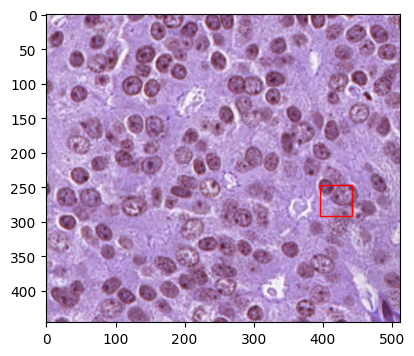

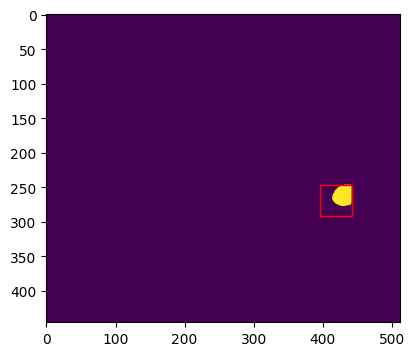

In [26]:
from PIL import Image
from torchvision.transforms import ToTensor
from tifffile import imread
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import json
from pprint import pprint
import array
root_dir = os.path.join(os.getcwd())
from utils import encode_mask, decode_maskobj

json_directory = 'test-results.json'

# open json file to see what the prediction should look like
with open(os.path.join(root_dir, json_directory)) as json_data:
    dset = json.load(json_data)
    json_data.close()
print(dset[0])

image_path = root_dir + "/test_release/c8cb7626-7423-4c1e-a81c-5ff25ea180b3.tif"
img = Image.open(image_path).convert("RGB")
print(dset)
print(dset[0]['segmentation'])
print(dset[0]['bbox'])
fig, ax = plt.subplots(figsize=(5, 4))
ax.imshow(img)
box =  dset[0]['bbox']
rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1], linewidth=1, edgecolor='r', facecolor='none')
ax.add_patch(rect)
rle_mask = dset[0]['segmentation']
decoded_mask = decode_maskobj(rle_mask)
fig, ax = plt.subplots(figsize=(5, 4))
ax.imshow(decoded_mask)
rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1], linewidth=1, edgecolor='r', facecolor='none')
ax.add_patch(rect)
plt.show()


# Check how model performs on example image

100


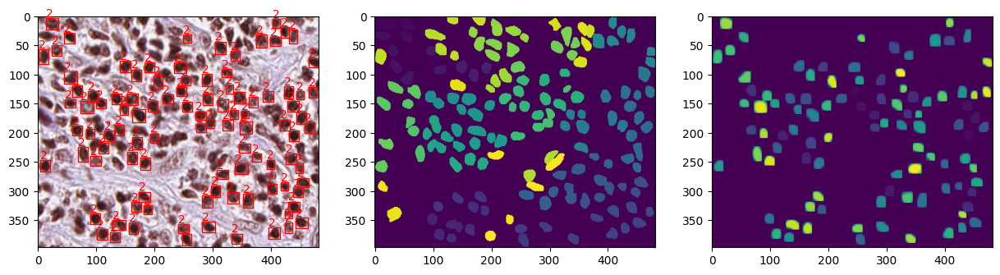

In [50]:
import cv2
import torchvision.transforms as transforms
from utils import encode_mask, decode_maskobj
import skimage.io as sio

CLASSES = [
    '0', '1', '2', '3', '4',
]

transform = transforms.Compose([
    transforms.PILToTensor()
])

pred_dict = []
image_id_list = []
pred_label_list = []
detection_threshold = 0
mask_threshold = 0.5

image_path = root_dir + "/sample-image/image.tif"
mask_path =  root_dir + "/sample-image/class2.tif"
mask_GT = sio.imread(mask_path)
img = Image.open(image_path).convert("RGB")
width = img.size[1]
height = img.size[0]
# save original dimensions before transform
orig_image = img.copy()
image = np.array(img).astype(np.float32)
image /= 255.0
# bring color channels to front
image = np.transpose(image, (2, 0, 1)).astype(np.float32)
img_tensor = torch.from_numpy(image).double()
# add batch dimension
img_tensor = torch.unsqueeze(img_tensor, 0)
with torch.no_grad():
    model=model.double()
    outputs = model(img_tensor.to(device))
    # load all detection to CPU for further operations
    outputs = [{k: v.to('cpu') for k, v in t.items()} for t in outputs]
    print(len(outputs[0]['boxes']))
    if len(outputs[0]['boxes']) != 0:
        boxes = outputs[0]['boxes'].data.numpy()
        scores = outputs[0]['scores'].data.numpy()
        masks = outputs[0]['masks'].data.numpy()
        # filter out boxes according to `detection_threshold`
        boxes = boxes[scores >= detection_threshold].astype(np.int32)
        masks = masks[masks >= detection_threshold].astype(np.int32)
        draw_boxes = boxes.copy()

        if len(boxes) != 0:
            # get all the predicited class names
            pred_classes = [CLASSES[i] for i in outputs[0]['labels'].cpu().numpy()]
            f, axarr = plt.subplots(1,3, figsize=(15, 10))
            axarr[0].imshow(orig_image)
            # draw the bounding boxes and write the class name on top of it
            class_name_list = []
            xmin_list = []
            final_mask_sum = np.zeros((orig_image.size[1], orig_image.size[0]))
            predictions = []
            for j, box in enumerate(draw_boxes):
                # resize the bounding boxes according to the desired `width`, `height`
                mask = outputs[0]['masks'][j]
                mask = mask.numpy()
                mask = mask.transpose(1, 2, 0)[:,:,-1]
                binary_mask = mask >= mask_threshold
                final_mask = np.zeros((mask.shape[0], mask.shape[1]))
                final_mask[box[1]:box[3],box[0]:box[2]] = mask[box[1]:box[3],box[0]:box[2]]
                mask = final_mask
                mask = mask* (j+1)
                class_name = pred_classes[j]
                class_name_list.append(pred_classes[j])
                rect = patches.Rectangle((box[0], box[1]), box[2] - box[0], box[3] - box[1], linewidth=1, edgecolor='r', facecolor='none')
                axarr[0].add_patch(rect)
                axarr[0].text(box[0], box[1]-2, class_name, color='red', fontsize=10)
                final_mask_sum = np.add(final_mask_sum, mask)

            axarr[1].imshow(mask_GT)
            axarr[2].imshow(final_mask_sum)

In [39]:
from PIL import Image
from torchvision.transforms import ToTensor
from tifffile import imread
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import json
from pprint import pprint
import array
import cv2
import torchvision.transforms as transforms
from utils import encode_mask, decode_maskobj
from tqdm.auto import tqdm

CLASSES = [
    '0', '1', '2', '3', '4',
]

transform = transforms.Compose([
    transforms.PILToTensor()
])

root_dir = os.path.join(os.getcwd())

json_directory = 'test_image_name_to_ids.json'
data_directory = '/test_release/'

with open(os.path.join(root_dir, json_directory)) as json_data:
    dset = json.load(json_data)
    json_data.close()
print(dset)
print(len(dset))

sorted_dict = {}

for element in dset:
    id = element['id']
    sorted_dict[id - 1] = {'file_name': element['file_name'], 'height': element['height'], 'width': element['width']}

print(sorted_dict[0])
print("Total number of images in test set: ", len(sorted_dict))

# start prediction
predictions = []
detection_threshold = 0
mask_threshold = 0.5

prog_bar = tqdm(sorted_dict, total=len(sorted_dict))

for i, data in enumerate(prog_bar):
    image_path = root_dir + data_directory + "/" + sorted_dict[i]['file_name']
    img = Image.open(image_path).convert("RGB")
    # save original dimensions before transform
    orig_image = img.copy()
    image = np.array(img).astype(np.float32)
    image /= 255.0
    # bring color channels to front
    image = np.transpose(image, (2, 0, 1)).astype(np.float32)
    img_tensor = torch.from_numpy(image).double()
    # add batch dimension
    img_tensor = torch.unsqueeze(img_tensor, 0)

    with torch.no_grad():
        model=model.double()
        outputs = model(img_tensor.to(device))
        # load all detection to CPU for further operations
        outputs = [{k: v.to('cpu') for k, v in t.items()} for t in outputs]
        if len(outputs[0]['boxes']) != 0:
            boxes = outputs[0]['boxes'].data.numpy()
            scores = outputs[0]['scores'].data.numpy()
            masks = outputs[0]['masks'].data.numpy()
            # filter out boxes according to `detection_threshold`
            boxes = boxes[scores >= detection_threshold].astype(np.float64)
            masks = masks[masks >= detection_threshold].astype(np.float64)
            draw_boxes = boxes.copy()

            if len(boxes) != 0:
                # get all the predicited class names
                pred_classes = [CLASSES[i] for i in outputs[0]['labels'].cpu().numpy()]
                for j, box in enumerate(draw_boxes):
                    # resize the bounding boxes according to the desired `width`, `height`
                    mask = outputs[0]['masks'][j]
                    mask = mask.numpy()
                    mask = mask.transpose(1, 2, 0)[:,:,-1]
                    final_mask = np.zeros((mask.shape[0], mask.shape[1]))
                    box_m = box.astype(np.int32)
                    final_mask[box_m[1]:box_m[3],box_m[0]:box_m[2]] = mask[box_m[1]:box_m[3],box_m[0]:box_m[2]]
                    mask = final_mask
                    binary_mask = mask >= mask_threshold

                    class_name = pred_classes[j]

                    rle_mask = encode_mask(binary_mask=binary_mask)
                    predictions.append({
                        'image_id': i + 1,
                        'bbox': [float(box[0]), float(box[1]), float(box[2]-box[0]), float(box[3]-box[1])],
                        'score': float(scores[j]),
                        'category_id': int(class_name),
                        'segmentation': rle_mask,
                    })

with open('/content/drive/MyDrive/Selected_Topics_HW3/output/test-results.json', 'w')as file:
    file.write(json.dumps(predictions, indent=4))


[{'file_name': 'c8cb7626-7423-4c1e-a81c-5ff25ea180b3.tif', 'id': 1, 'height': 446, 'width': 512}, {'file_name': '8bf17017-577c-4bc7-b599-df8289a69279.tif', 'id': 2, 'height': 151, 'width': 147}, {'file_name': 'acaf16a8-d1e6-4746-92ae-c76fa82cb70d.tif', 'id': 3, 'height': 384, 'width': 497}, {'file_name': 'd1289bd6-5115-4c7b-a2fe-d0312f2f209a.tif', 'id': 4, 'height': 653, 'width': 664}, {'file_name': '009510f3-2d1a-435e-b733-90f5450baaca.tif', 'id': 5, 'height': 655, 'width': 787}, {'file_name': 'c911338d-ec00-46d3-a9bc-9953d0d5bdc9.tif', 'id': 6, 'height': 743, 'width': 435}, {'file_name': 'c621555b-a04b-4c5e-9eeb-d66e7e1c754c.tif', 'id': 7, 'height': 221, 'width': 242}, {'file_name': '24f246b8-e442-4312-8088-c6ed2eabeaf6.tif', 'id': 8, 'height': 1315, 'width': 1460}, {'file_name': 'eaccffed-97b8-4103-9db0-3e319c6a1d3b.tif', 'id': 9, 'height': 566, 'width': 615}, {'file_name': '1dc79238-44b9-4274-bedd-5955019b1364.tif', 'id': 10, 'height': 1400, 'width': 1872}, {'file_name': 'bd0cc05f-

  0%|          | 0/101 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [14]:
with open('/content/drive/MyDrive/Selected_Topics_HW3/output/test-results.json') as json_data:
    dset = json.load(json_data)
    json_data.close()
print(dset)

[{'image_id': 1, 'bbox': [481.377475745242, 44.07199120860084, 24.946694342760907, 23.269973203841708], 'score': 0.9725288204758825, 'category_id': 1, 'segmentation': {'size': [446, 512], 'counts': '`oa69b=5M1O2N2O0O2O001O0O100000000001O0O101O0O2N2N2MUb2'}}, {'image_id': 1, 'bbox': [315.88493199984754, 199.97020216387108, 20.64499146621688, 28.007487905947983], 'score': 0.9568904471154245, 'category_id': 1, 'segmentation': {'size': [446, 512], 'counts': 'hXZ4;a=4M2N2N2N2N1O1O100O100000O2N1O2N1O3Lf^\\2'}}, {'image_id': 1, 'bbox': [186.53895685926736, 192.0629759628524, 24.087283906064158, 26.432763965038163], 'score': 0.9565940532291417, 'category_id': 1, 'segmentation': {'size': [446, 512], 'counts': 'gVa22i=8I5L2N3M1O2O1O000O100000000001N2O0O101N2N2N2OmZS4'}}, {'image_id': 1, 'bbox': [263.1534041447587, 89.72992712025979, 24.56448003833026, 25.766899989296505], 'score': 0.9509022273846878, 'category_id': 1, 'segmentation': {'size': [446, 512], 'counts': 'dRc35d=9K2N2N2O0O3M101O0000000